## Instructions

1. **Labeling & Peer Grading:** Your homework will be peer graded. To stay anonymous, avoid using your name and label your file with the last four digits of your student ID (e.g., HW#_Solutions_3938).

2. **Submission:** Submit both your IPython notebook (.ipynb) and an HTML file of the notebook to Canvas under Assignments → HW # → Submit Assignment. After submitting, download and check the files to make sure that you've uploaded the correct versions. Both files are required for your HW to be graded.
3. 
 <font color='red'> No pdf file required so write all the details in your ipynb file.</font>
2. **AI Use Policy:** Solve each problem independently by yourself. Use AI tools like ChatGPT or Google Gemini for brainstorming and learning only—copying AI-generated content is prohibited. You do not neeViolations will lead to penalties, up to failing the course.

3. **Problem Structure:** <font color='red'>Break down each problem ( already done in most problems) into three interconnected parts and implement each in separate code cells. Ensure that each part logically builds on the previous one. Include comments in your code to explain its purpose, followed by a Markdown cell analyzing what was achieved. After completing all parts, add a final Markdown cell reflecting on your overall approach, discussing any challenges faced, and explaining how you utilized AI tools in your process.
</font>
4. **Deadlines & Academic Integrity:** This homework is due on 11/05/2024 at midnight. <font color='red'>Disclosure of this assignment and assignment answers to anyone or any website is a contributory infringement of academic dishonesty at ISU. Do not share or post course materials without the express written consent of the copyright holder and instructor. The class will follow Iowa State University’s policy on academic dishonesty. Anyone suspected of academic dishonesty will be reported to the Dean of Students Office.</font>

#### Each problem is worth 25 points. Total $\bf 25\times 4 = 100$.

### Problem 1. 
Upload the sn_ids.csv and do the following. Make sure to explain all the details for each part.
* Apply the PageRank algorithm to compute the rank for each ID in the network. Sort the results in descending order, round the PageRank values to 3 decimals, and create a DataFrame with two columns: "ids" and "PageRank."
* From the PageRank DataFrame, select the top 5 IDs and use them to filter the original sn_ids.csv based on 'id_1' and 'id_2'. Plot the network graph of the filtered data with figsize(50, 50) and use different colors for "id_1" and "id_2."
* Repeat part 1 using the HITS algorithm to compute authority and hub scores. Then, select the top 5 IDs based on authority values and repeat part 2 to filter and plot the network graph.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', 20)

In [2]:
data_loc = "/Users/gabrielvictorgomesferreira/Library/Mobile Documents/com~apple~CloudDocs/Work/ISU Classes/Data/"
file_name = "sn_ids.csv"

In [3]:
sn_df = pd.read_csv(data_loc + file_name)
rows, columns = sn_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
sn_df.head(5)

The dataset contains 289,003 rows and 2 columns


,id_1,id_2
0,0,23977
1,1,34526
2,1,2370
3,1,14683
4,1,29982


* Apply the PageRank algorithm to compute the rank for each ID in the network. Sort the results in descending order, round the PageRank values to 3 decimals, and create a DataFrame with two columns: "ids" and "PageRank."

In [12]:
import networkx as nx
import matplotlib.pyplot as plt
from sknetwork.data import Bunch 
from sknetwork.ranking import PageRank 
from scipy.sparse import csr_matrix

In [108]:
# Convert the data to a directed graph
G = nx.from_pandas_edgelist(sn_df, 'id_1', 'id_2', create_using=nx.DiGraph)

# Convert the NetworkX graph to a sparse CSR matrix
adjacency = csr_matrix(nx.to_scipy_sparse_array(G, dtype=None, weight='weight', format='csr'))
names = np.array(list(G.nodes()))
graph = Bunch()
graph.adjacency = adjacency
graph.names = names

# Apply the PageRank algorithm
pagerank = PageRank()
pagerank.fit(adjacency)
scores = pagerank.scores_
scores = [round(score, 3) for score in scores]

# Convert the PageRank scores to a DataFrame
pagerank_df = pd.DataFrame({'ids': names, 'PageRank': scores}).sort_values(by='PageRank', ascending=False).reset_index(drop=True)
pagerank_df.head()

,ids,PageRank
0,31890,0.015
1,36652,0.013
2,18163,0.010
3,36628,0.010
4,34114,0.006


* From the PageRank DataFrame, select the top 5 IDs and use them to filter the original sn_ids.csv based on 'id_1' and 'id_2'. Plot the network graph of the filtered data with figsize(50, 50) and use different colors for "id_1" and "id_2."

In [103]:
# Select the top 5 IDs
top_5_ids = pagerank_df['ids'].head(5).tolist()

# Filter data based on the top 5 IDs
filtered_df = sn_df[(sn_df['id_1'].isin(top_5_ids)) | (sn_df['id_2'].isin(top_5_ids))]
# filtered_df = filtered_df[0:2000]
filtered_df


,id_1,id_2
22,6,31890
38,34957,31890
45,8,36652
69,10,31890
123,11,31890
...,...,...
288973,12628,34114
288976,34114,37535
288977,34114,37431
288978,34114,37460


### Plot the Network Graph

#### Network Graph Based on PageRank Analysis (with full filtered data)

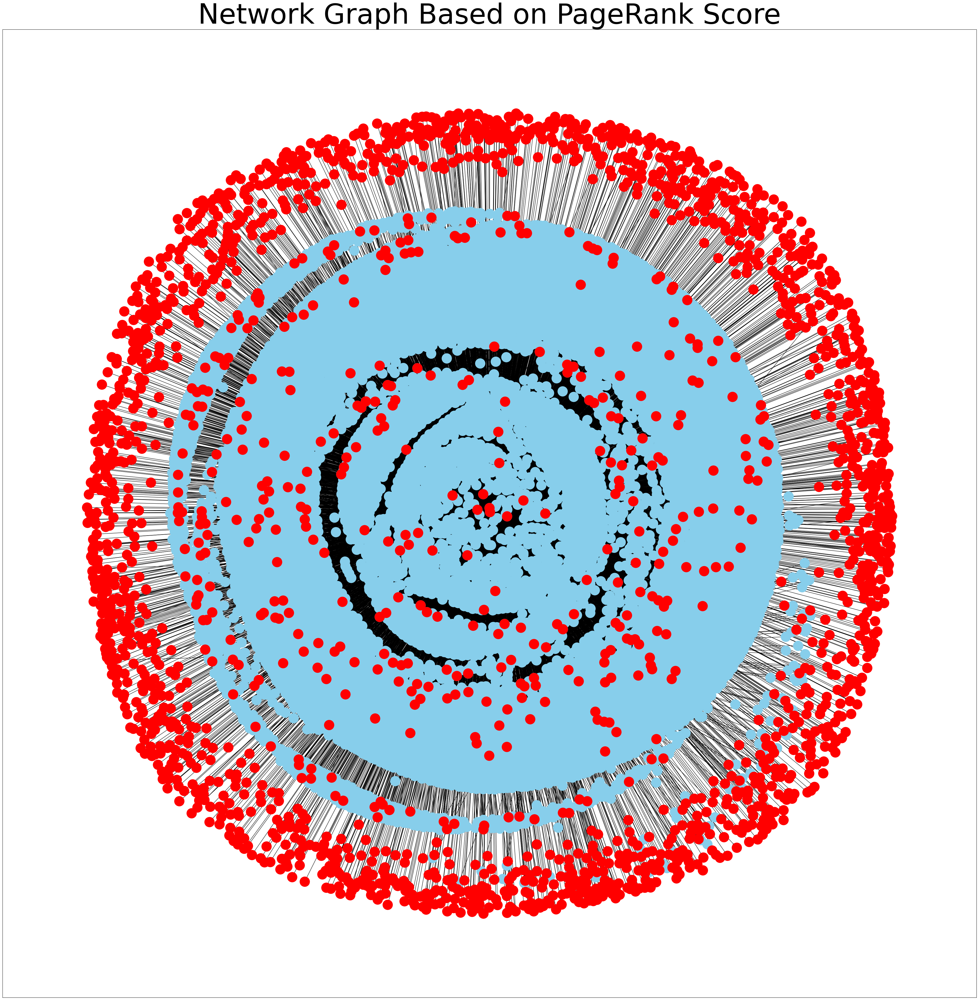

In [96]:
# Create the directed graph from the filtered data
G = nx.from_pandas_edgelist(filtered_df, 'id_1', 'id_2', create_using=nx.DiGraph())

# Set up plot with figsize of 50x50
plt.figure(figsize=(50, 50))

# Position the nodes using a spring layout
pos = nx.spring_layout(G, k=0.1)

# Draw nodes with different colors for "id_1" and "id_2"
id_1_nodes = filtered_df['id_1'].unique()
id_2_nodes = filtered_df['id_2'].unique()

# Draw nodes from "id_1" in blue and nodes from "id_2" in green
nx.draw_networkx_nodes(G, pos, nodelist=id_1_nodes, node_color='skyblue', node_size=800)
nx.draw_networkx_nodes(G, pos, nodelist=id_2_nodes, node_color='red', node_size=800)

# Draw edges
nx.draw_networkx_edges(G, pos, edge_color='black', width=1)

# Set the plot title
plt.title(f"Network Graph Based on PageRank Score", size=80)
plt.show()

Based from the above network graph, is hard to derive conlusions and insights due to the high volume of the dataset.

The initial dataset has 289,003 connections. After selecting the top 5 IDs based on the PageRank score and use them to filter the original sn_ids.csv based on 'id_1' and 'id_2', the volume of the dataset reduces to 15,631 connections. This is represents a 94.59% data volume reduction. 

To make the graph more interpretable, a further reduction or sampling of the filtered data is necessary. By visualizing a smaller subset, we can better observe the hierarchical or clustered structures around these influential nodes. This refined approach facilitates a clearer understanding of relationships and potential key influencers in the network, offering valuable insights for applications like social network analysis or recommendation systems.

#### Network Graph Based on PageRank Analysis (with a subset of filtered data)

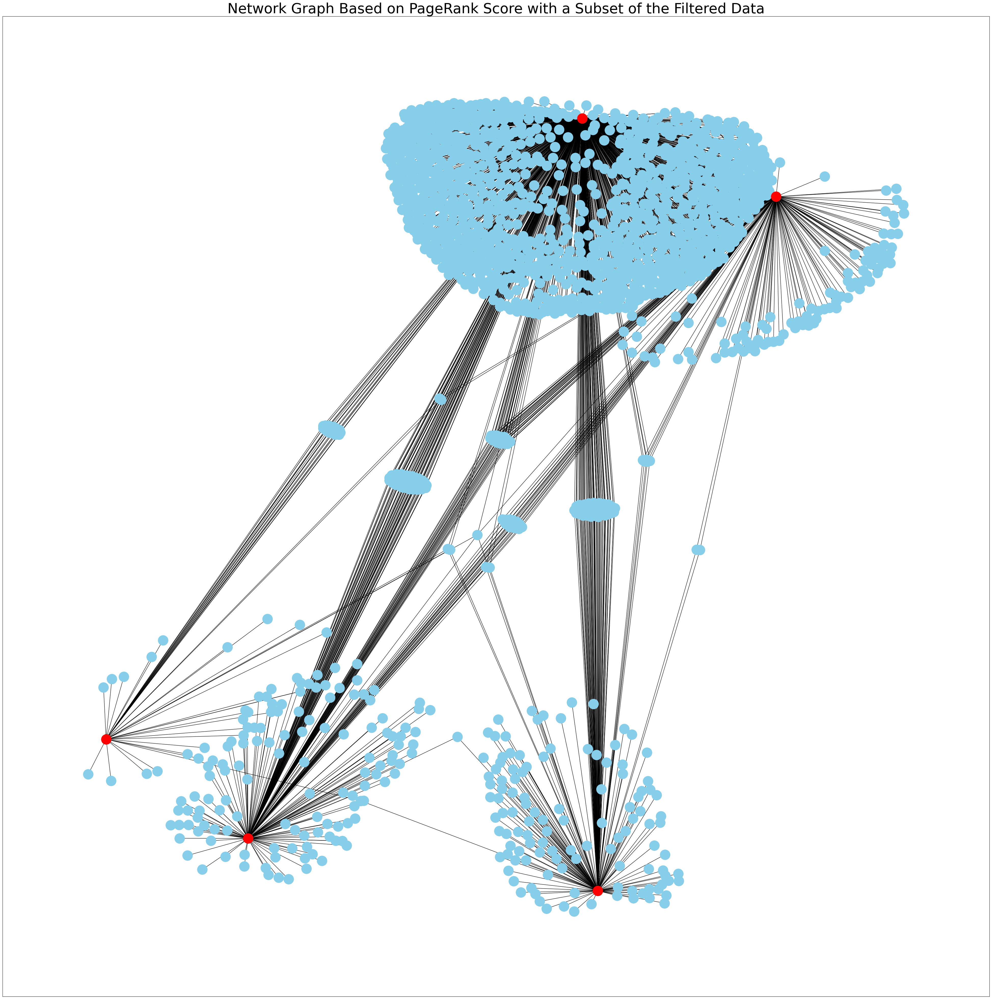

In [109]:
# Select the top 5 IDs
top_5_ids = pagerank_df['ids'].head(5).tolist()

# Filter data based on the top 5 IDs
filtered_df = sn_df[(sn_df['id_1'].isin(top_5_ids)) | (sn_df['id_2'].isin(top_5_ids))]
filtered_df = filtered_df[0:2000]

# Create the directed graph from the filtered data
G = nx.from_pandas_edgelist(filtered_df, 'id_1', 'id_2', create_using=nx.DiGraph())

# Set up plot with figsize of 50x50
plt.figure(figsize=(50, 50))

# Position the nodes using a spring layout
pos = nx.spring_layout(G, k=0.1)

# Draw nodes with different colors for "id_1" and "id_2"
id_1_nodes = filtered_df['id_1'].unique()
id_2_nodes = filtered_df['id_2'].unique()

# Draw nodes from "id_1" in blue and nodes from "id_2" in green
nx.draw_networkx_nodes(G, pos, nodelist=id_1_nodes, node_color='skyblue', node_size=800)
nx.draw_networkx_nodes(G, pos, nodelist=id_2_nodes, node_color='red', node_size=800)

# Draw edges
nx.draw_networkx_edges(G, pos, edge_color='black', width=1)

# Set the plot title
plt.title(f"Network Graph Based on PageRank Score with a Subset of the Filtered Data", size=40)
plt.show()

This network graph, based on PageRank scores with a subset of filtered data, highlights the influence of key nodes (in red) within the network. These red nodes, positioned centrally, connect to multiple clusters, indicating their role as influential hubs. The structure shows a distinct hub-and-spoke pattern, with central nodes linking to numerous smaller nodes. This setup suggests a hierarchical relationship, where these hubs act as primary connectors, facilitating interaction across different parts of the network. Despite the data reduction, the high connectivity still demonstrates the importance of these influential nodes in maintaining the network's overall structure.

* Repeat part 1 using the HITS algorithm to compute authority and hub scores. Then, select the top 5 IDs based on authority values and repeat part 2 to filter and plot the network graph.

### Compute HITS Algorithm and Extract Hub and Authority Scores

In [111]:
# Convert the data to a directed graph
G = nx.from_pandas_edgelist(sn_df, 'id_1', 'id_2', create_using=nx.DiGraph())
H = G.to_directed()

# Apply the HITS algorithm
hubs, authorities = nx.hits(H, max_iter = 50, normalized = True)
ids = list(authorities.keys())
hub_scores = [round(value, 3) for value in hubs.values()]
authorities_scores = [round(value, 3) for value in list(authorities.values())]

# Convert the authority scores into a DataFrame
authority_df = pd.DataFrame({
    'ids': ids, 
    'Hub Score': hub_scores,
    'Authority': authorities_scores     
}).sort_values(by='Authority', ascending=False).reset_index(drop=True)

authority_df.head()

,ids,Hub Score,Authority
0,31890,0.001,0.010
1,35773,0.001,0.003
2,36652,0.000,0.002
3,19222,0.001,0.002
4,35008,0.000,0.002


In [97]:
# Select the top 5 IDs based on Authority values
top_5_ids = authority_df['ids'].head(5).tolist()

# Filter the original data based on the top 5 Authority IDs
filtered_df = sn_df[(sn_df['id_1'].isin(top_5_ids)) | (sn_df['id_2'].isin(top_5_ids))]
# filtered_df = filtered_df[0:2000]
filtered_df

,id_1,id_2
22,6,31890
28,7,35773
38,34957,31890
45,8,36652
69,10,31890
...,...,...
288795,36652,33051
288796,36652,37649
288797,36652,25233
288798,36652,37672


### Plot the Network Graph

#### Network Graph Based on HITS Authority Analysis (with full filtered data)

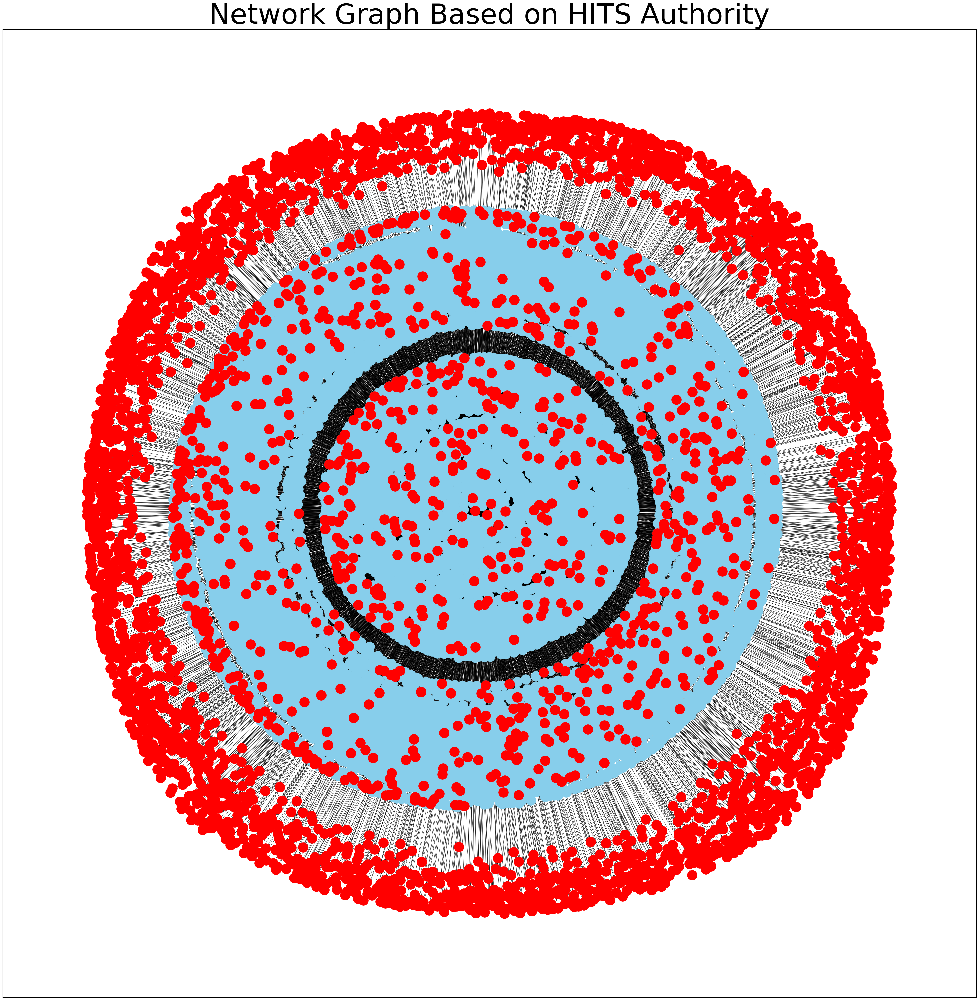

In [98]:
# Create a graph for the filtered data
G_filtered = nx.from_pandas_edgelist(filtered_df, 'id_1', 'id_2', create_using=nx.DiGraph())

# Set up plot with figsize of 50x50
plt.figure(figsize=(50, 50))

# Position the nodes using a spring layout
pos = nx.spring_layout(G_filtered, k=0.1)

# Draw nodes with different colors for "id_1" and "id_2"
id_1_nodes = filtered_df['id_1'].unique()
id_2_nodes = filtered_df['id_2'].unique()

# Draw nodes from "id_1" in blue and nodes from "id_2" in green
nx.draw_networkx_nodes(G_filtered, pos, nodelist=id_1_nodes, node_color='skyblue', node_size=800)
nx.draw_networkx_nodes(G_filtered, pos, nodelist=id_2_nodes, node_color='red', node_size=800)

# Draw edges
nx.draw_networkx_edges(G_filtered, pos, edge_color='black', width=0.5)


# Set the plot title
plt.title(f"Network Graph Based on HITS Authority", size=80)
plt.show()

This HITS-based network graph, like the previous PageRank graph, shows a highly dense structure with numerous connections, making it challenging to derive meaningful insights at this level of complexity. The red nodes likely represent high-authority nodes, surrounded by many other nodes connecting to them.

The structure reveals a layered organization with core nodes in the center and outer nodes connected to them, indicating a potential hierarchical or influential relationship. However, the density of connections obscures specific patterns, highlighting the need for further filtering or sampling to create a more interpretable visualization. By focusing on a representative subset of the data, we can better understand the core connection patterns and influence of high-authority nodes within this network.

#### Network Graph Based on PageRank Analysis (with a subset of filtered data)

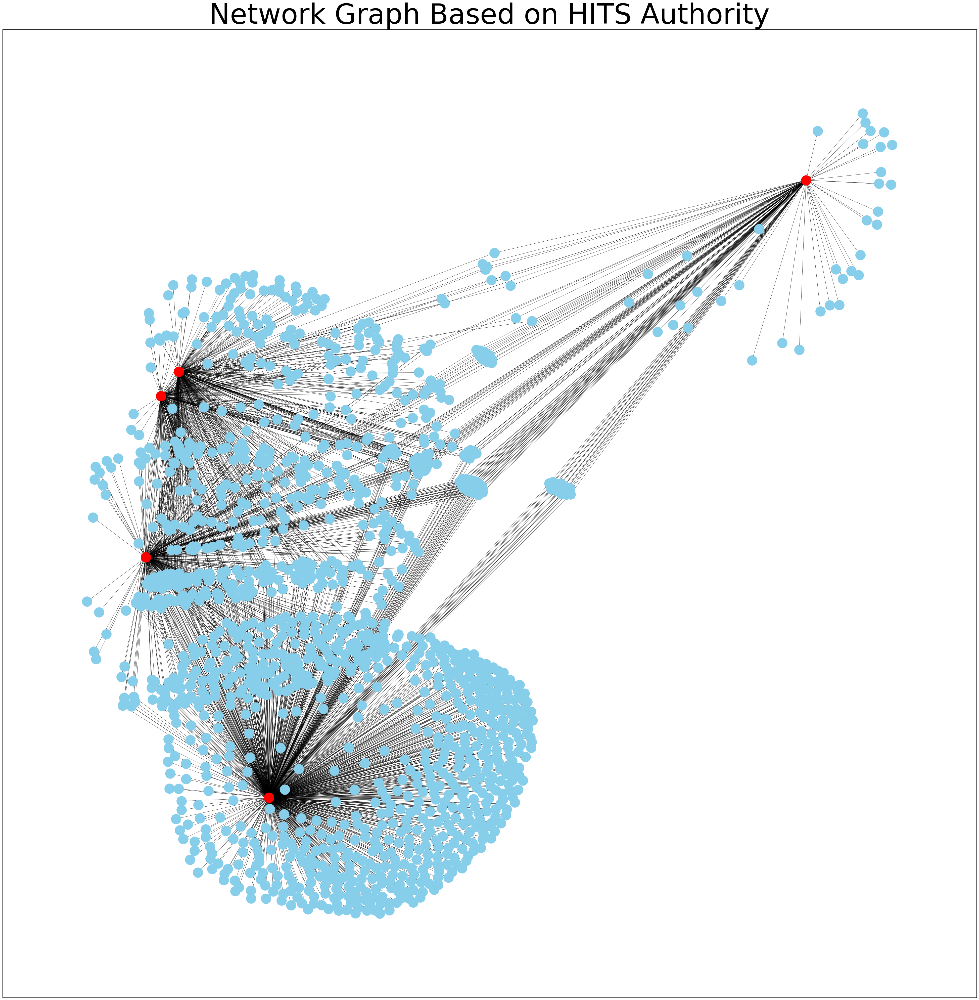

In [112]:
# Select the top 5 IDs based on Authority values
top_5_ids = authority_df['ids'].head(5).tolist()

# Filter the original data based on the top 5 Authority IDs
filtered_df = sn_df[(sn_df['id_1'].isin(top_5_ids)) | (sn_df['id_2'].isin(top_5_ids))]
filtered_df = filtered_df[0:2000]

# Create a graph for the filtered data
G_filtered = nx.from_pandas_edgelist(filtered_df, 'id_1', 'id_2', create_using=nx.DiGraph())

# Set up plot with figsize of 50x50
plt.figure(figsize=(50, 50))

# Position the nodes using a spring layout
pos = nx.spring_layout(G_filtered, k=0.1)

# Draw nodes with different colors for "id_1" and "id_2"
id_1_nodes = filtered_df['id_1'].unique()
id_2_nodes = filtered_df['id_2'].unique()

# Draw nodes from "id_1" in blue and nodes from "id_2" in green
nx.draw_networkx_nodes(G_filtered, pos, nodelist=id_1_nodes, node_color='skyblue', node_size=800)
nx.draw_networkx_nodes(G_filtered, pos, nodelist=id_2_nodes, node_color='red', node_size=800)

# Draw edges
nx.draw_networkx_edges(G_filtered, pos, edge_color='black', width=0.5)


# Set the plot title
plt.title(f"Network Graph Based on HITS Authority", size=80)
plt.show()

This network graph of 2,000 connections highlights 5 high-authority nodes (in red) with dense clusters of blue nodes connected to them. The red nodes demonstrate strong influence, attracting multiple connections. Some blue nodes link to more than one high-authority node, acting as bridges across clusters and enhancing interconnectivity. This clearer view emphasizes the role of high-authority nodes in structuring the network and connecting communities.

##### Disclaimer: Problems 2 and 3 are for learning purposes only and not a financial advice.

### Problem 2. 
Do the following using the Yahoo Finance package. As usual, write the analysis details and explain all that you do for each part.
* Download the data for the 20 ticker symbols. Create a DataFrame with 3 columns: Ticker Symbol, Top 10 institutional holders of each ticker, and the corresponding holding amounts in dollars.
* Using the DataFrame, build a network graph where the institutional holders are the source and ticker symbols are the target. Label the nodes and use different colors for the source (holders) and the target (tickers). Adjust the edge thickness based on normalized holding amounts, and scale the size of ticker symbols by their degree.
* Modify the graph from part 2 to improve its appearance by making at least one change—such as color, layout, or size—so that the graph looks better in your view. 

In [147]:
import pandas as pd
import yfinance as yf
import numpy as np
import requests

In [144]:
top20_tickers = ["AAPL", "AMZN", "MSFT", "GOOG", "GOOGL", "META", "TSLA", "NVDA", "JPM", "JNJ", "V", "PG",
                 "UNH", "HD", "MA", "BAC", "DIS", "PYPL", "NFLX", "ADBE"]

* Download the data for the 20 ticker symbols. Create a DataFrame with 3 columns: Ticker Symbol, Top 10 institutional holders of each ticker, and the corresponding holding amounts in dollars.

In [146]:
# Initialize an empty DataFrame to store results
all_holders = pd.DataFrame()

for ticker in top20_tickers:
    stock = yf.Ticker(ticker)
    institutional_holders = stock.institutional_holders
    institutional_holders['Ticker'] = ticker
    all_holders = pd.concat([all_holders, institutional_holders.head(10)], ignore_index=True)

all_holders = all_holders[['Ticker', 'Holder', 'Value']]
rows, columns = all_holders.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
all_holders.head(5)

The dataset contains 200 rows and 3 columns


,Ticker,Holder,Value
0,AAPL,Vanguard Group Inc,252876459508
1,AAPL,Blackrock Inc.,201659137420
2,AAPL,"Berkshire Hathaway, Inc",177591247296
3,AAPL,State Street Corporation,112288817516
4,AAPL,"FMR, LLC",59561715772


* Using the DataFrame, build a network graph where the institutional holders are the source and ticker symbols are the target. Label the nodes and use different colors for the source (holders) and the target (tickers). Adjust the edge thickness based on normalized holding amounts, and scale the size of ticker symbols by their degree.

In [ ]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from IPython.display import SVG 
from sknetwork.visualization import svg_graph 
from sknetwork.data import Bunch 
from sknetwork.ranking import PageRank
from scipy.sparse import csr_matrix

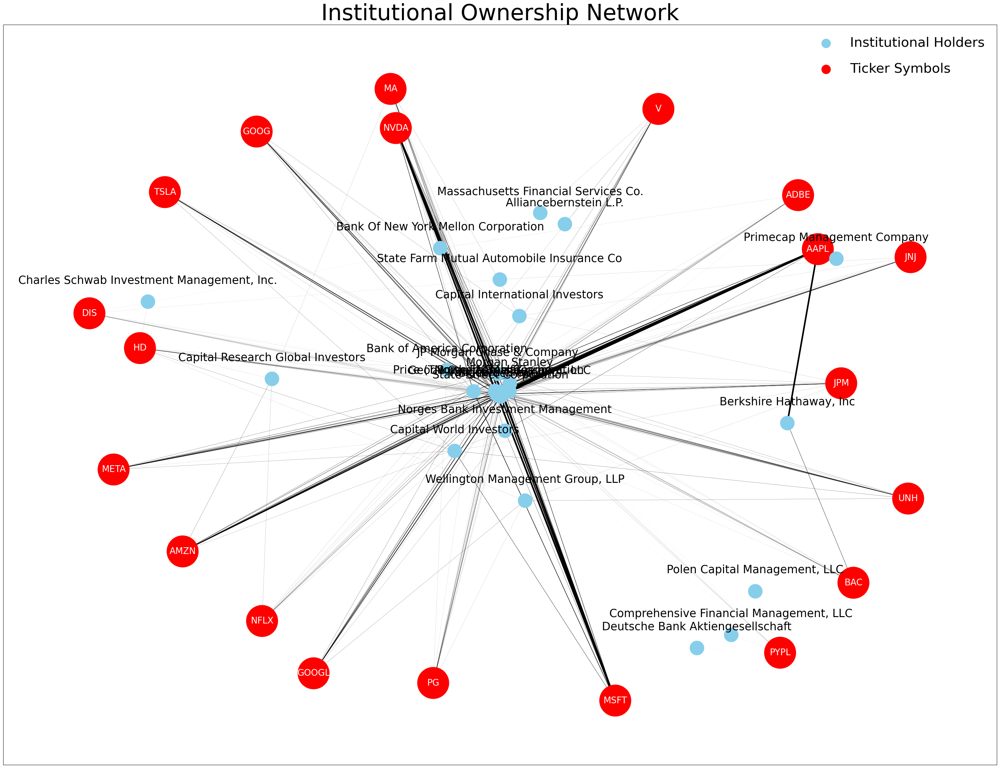

In [272]:
holder_color = "skyblue"
ticker_color = "red"
holder_size = 1000

# Normalize holding values for edge thickness
all_holders['Normalized Value'] = all_holders['Value'] / all_holders['Value'].max()

# Create directed graph
G = nx.from_pandas_edgelist(all_holders, 'Holder', 'Ticker', ['Value'], create_using=nx.DiGraph())

# Set up plot with figsize of 50x50
plt.figure(figsize=(40, 30))

# Draw nodes
holders = [node for node in G.nodes() if node in all_holders['Holder'].values]
tickers = [node for node in G.nodes() if node in all_holders['Ticker'].values]

# Define positions using spring layout for a more organic structure
pos = nx.spring_layout(G, k=0.3, seed=42)

# Scale ticker sizes by degree (number of connections)
ticker_sizes = [G.degree(ticker) * 500 for ticker in tickers]

# Draw nodes from holders in blue and nodes from tickers in green
nx.draw_networkx_nodes(G, pos, nodelist=tickers, node_color=ticker_color, node_size=ticker_sizes)
nx.draw_networkx_nodes(G, pos, nodelist=holders, node_color=holder_color, node_size=holder_size)

# Draw labels for holders slightly outside the nodes
holder_labels = {node: node for node in holders}
holder_label_pos = {node: (pos[node][0], pos[node][1] + 0.05) for node in holders}  # Offset for visibility
nx.draw_networkx_labels(G, holder_label_pos, labels=holder_labels, font_size=25, verticalalignment="bottom")

# Draw edges with thickness based on normalized holding values
edge_widths = [all_holders.loc[(all_holders['Holder'] == u) & (all_holders['Ticker'] == v), 'Normalized Value'].values[0] * 5 for u, v in G.edges()]
nx.draw_networkx_edges(G, pos, edge_color='black', width=edge_widths)

# Draw labels for tickers inside the nodes
ticker_labels = {node: node for node in tickers}
nx.draw_networkx_labels(G, pos, labels=ticker_labels, font_size=20, font_color="white")

# Create a legend
plt.scatter([], [], c=holder_color, label='Institutional Holders', s=400)
plt.scatter([], [], c=ticker_color, label='Ticker Symbols', s=400)
plt.legend(scatterpoints=1, frameon=False, labelspacing=1, loc='upper right', fontsize=30)

# Set the plot title
plt.title(f"Institutional Ownership Network", size=50)
plt.show()

* Modify the graph from part 2 to improve its appearance by making at least one change—such as color, layout, or size—so that the graph looks better in your view. 

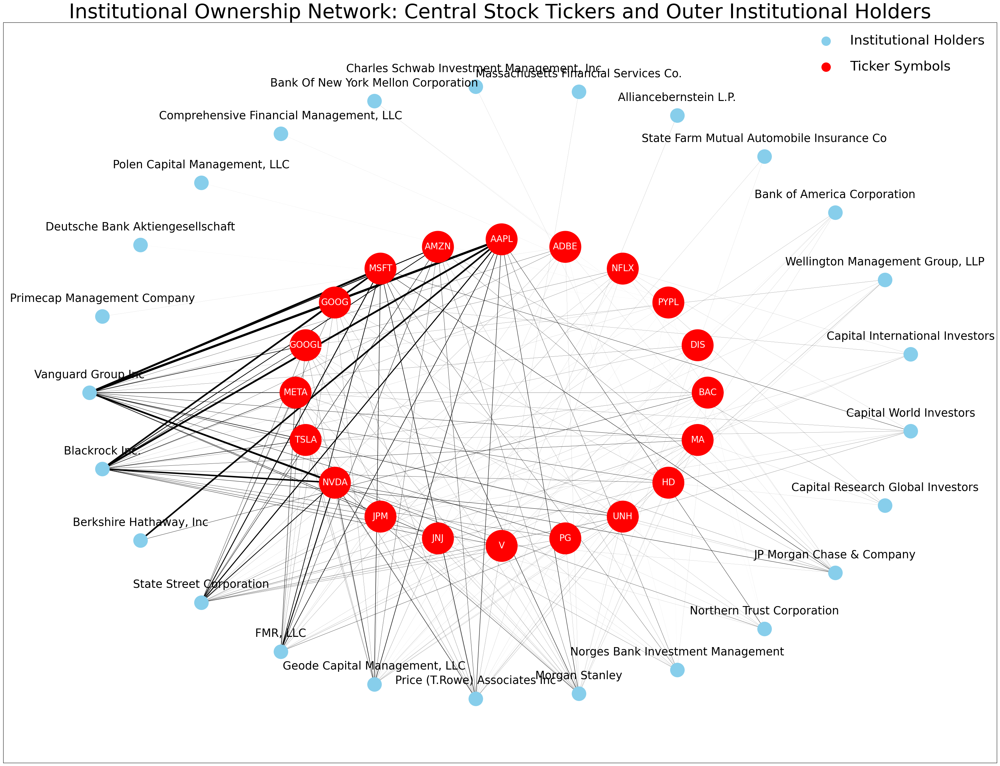

In [276]:
holder_color = "skyblue"
ticker_color = "red"
holder_size = 1000

# Normalize holding values for edge thickness
all_holders['Normalized Value'] = all_holders['Value'] / all_holders['Value'].max()

# Create directed graph
G = nx.from_pandas_edgelist(all_holders, 'Holder', 'Ticker', ['Value'], create_using=nx.DiGraph())

# Set up plot with figsize of 50x50
plt.figure(figsize=(40, 30))

# Draw nodes
holders = [node for node in G.nodes() if node in all_holders['Holder'].values]
tickers = [node for node in G.nodes() if node in all_holders['Ticker'].values]

# Use shell layout to position tickers in the center and holders outside
pos = nx.shell_layout(G, nlist=[tickers, holders])

# Scale ticker sizes by degree (number of connections)
ticker_sizes = [G.degree(ticker) * 500 for ticker in tickers]

# Draw nodes from holders in blue and nodes from tickers in green
nx.draw_networkx_nodes(G, pos, nodelist=tickers, node_color=ticker_color, node_size=ticker_sizes)
nx.draw_networkx_nodes(G, pos, nodelist=holders, node_color=holder_color, node_size=holder_size)

# Draw labels for holders slightly outside the nodes
holder_labels = {node: node for node in holders}
holder_label_pos = {node: (pos[node][0], pos[node][1] + 0.04) for node in holders}  # Offset for visibility
nx.draw_networkx_labels(G, holder_label_pos, labels=holder_labels, font_size=25, verticalalignment="bottom")

# Draw edges with thickness based on normalized holding values
edge_widths = [all_holders.loc[(all_holders['Holder'] == u) & (all_holders['Ticker'] == v), 'Normalized Value'].values[0] * 5 for u, v in G.edges()]
nx.draw_networkx_edges(G, pos, edge_color='black', width=edge_widths)

# Draw labels for tickers inside the nodes
ticker_labels = {node: node for node in tickers}
nx.draw_networkx_labels(G, pos, labels=ticker_labels, font_size=20, font_color="white")

# Create a legend
plt.scatter([], [], c=holder_color, label='Institutional Holders', s=400)
plt.scatter([], [], c=ticker_color, label='Ticker Symbols', s=400)
plt.legend(scatterpoints=1, frameon=False, labelspacing=1, loc='upper right', fontsize=30)
plt.title(f"Institutional Ownership Network: Central Stock Tickers and Outer Institutional Holders", size=45)
plt.show()

This network visualization highlights the relationships between major institutional holders (in blue) and top stock tickers (in red). By centralizing the stock tickers and placing institutional holders around them, the graph clearly illustrates how multiple institutions are connected to popular stocks. The varying edge thickness, based on normalized holding amounts, provides a visual cue of the strength of each institutional investment in a particular stock. The size of the nodes don't vary a lot because all stickers have 10 institutional holders. This layout emphasizes the most influential stocks in attracting significant institutional investment and the diverse range of institutions supporting these key assets.

### Problem 3.  
Do the following and write the findings from your anslysis.
* Use web scraping to collect 25 news articles or titles for each of the 20 stocks listed in the previous problem. Organize the information into a DataFrame with three columns: Date, Journalist, and Article content (or titles if the full article is not accessible). This approach ensures you can proceed even if gathering full articles is challenging
* Perform sentiment analysis on the articles collected in part 1 using TextBlob. Sort the resulting DataFrame by sentiment scores to rank the articles by sentiment positivity.
* Repeat the sentiment analysis using a Naive Bayes classifier. Compare the results from TextBlob and Naive Bayes to select 10 stocks for your portfolio based on the most positive sentiment trends.

In [294]:
import newspaper
from newspaper import Article 
from tqdm import tqdm 
import wikipedia as wiki 
from GoogleNews import GoogleNews

* Use web scraping to collect 25 news articles or titles for each of the 20 stocks listed in the previous problem. Organize the information into a DataFrame with three columns: Date, Journalist, and Article content (or titles if the full article is not accessible). This approach ensures you can proceed even if gathering full articles is challenging

In [310]:
from datetime import datetime, timedelta
import re

# Function to parse relative dates
def parse_relative_date(relative_date_str):
    now = datetime.now()
    
    if 'hour' in relative_date_str:
        hours = int(re.search(r'\d+', relative_date_str).group())
        return now - timedelta(hours=hours)
    elif 'minute' in relative_date_str:
        minutes = int(re.search(r'\d+', relative_date_str).group())
        return now - timedelta(minutes=minutes)
    elif 'day' in relative_date_str:
        days = int(re.search(r'\d+', relative_date_str).group())
        return now - timedelta(days=days)
    elif 'week' in relative_date_str:
        weeks = int(re.search(r'\d+', relative_date_str).group())
        return now - timedelta(weeks=weeks)
    else:
        return now  # If date format is not recognized, default to now

In [337]:
from GoogleNews import GoogleNews
from newspaper import Article
import pandas as pd

# Initialize GoogleNews with the language set to English
googlenews = GoogleNews(lang='en')
googlenews.set_encode('utf-8')

# Define the stock ticker
ticker = "AMZN"  # Example: Apple Inc.

# Search for news articles related to the ticker
googlenews.search(ticker)

# Collect distinct articles from the first two pages
news_results = []
unique_titles = set()

for page in range(1, 5):  # Retrieve pages 1 and 2
    googlenews.getpage(page)
    page_results = googlenews.result()
    
    # Filter duplicates by title
    for news in page_results:
        title = news.get('title', None)
        
        # Check if title is unique and we haven't reached 25 articles
        if title and title not in unique_titles:
            unique_titles.add(title)  # Add title to the set of seen titles
            news_results.append(news)  # Add the unique article to results

        # Stop once we have 25 unique articles
        if len(news_results) >= 25:
            break
    if len(news_results) >= 25:
        break

# Convert to DataFrame if needed
articles_df = pd.DataFrame(news_results)
print(articles_df)

                                                title                   media  \
0   Google, Meta, Amazon, Flipkart boost ad revenu...            Storyboard18   
1   Amazon's Q3 ad revenue rises 19% YoY, reaches ...                     BMI   
2   Amazon share prices jump, catapult Jeff Bezos ...              News9 LIVE   
3   Amazon India's Great Indian Festival 2024 Achi...             Goodreturns   
4   Amazon's ad revenue up 24% to $47B; AI emerges...            Storyboard18   
5   Ethereum is like ‘Amazon in the 1990s’ — 21Shares                     MSN   
6   Amazon sees massive traffic from non-metro cit...          Business Today   
7   Amazon's big tech plans pay off for customers ...               TheStreet   
8   Amazon Shares Surge 6% as Earnings Beat Expect...                     MSN   
9   Jeff Bezos Sells Over $3 Billion in Amazon Sha...                     MSN   
10  AAPL vs. AMZN: Here’s the Better AI Stock Goin...           24/7 Wall St.   
11  Amazon Earns Another Qua

In [ ]:
unique_titles = set()

for page in range(1, 5):  # Retrieve pages 1 and 2
    googlenews.getpage(page)
    page_results = googlenews.result()
    
    # Filter duplicates by title
    for news in page_results:
        title = news.get('title', None)
        
        # Check if title is unique and we haven't reached 25 articles
        if title and title not in unique_titles:
            unique_titles.add(title)  # Add title to the set of seen titles
            news_results.append(news)  # Add the unique article to results

        # Stop once we have 25 unique articles
        if len(news_results) >= 25:
            break
    if len(news_results) >= 25:
        break


In [338]:
# Define list of stock tickers
top20_tickers = ["AAPL", "AMZN", "MSFT", "GOOG", "GOOGL", "META", "TSLA", "NVDA", "JPM", "JNJ", 
                 "V", "PG", "UNH", "HD", "MA", "BAC", "DIS", "PYPL", "NFLX", "ADBE"]
top20_tickers = ["AAPL", "AMZN"]

# Define date range for recent articles
googlenews = GoogleNews(lang='en')
googlenews.set_encode('utf-8')

# Initialize an empty list to store article data
articles_data = []

for ticker in tqdm(top20_tickers, desc="Fetching articles for stocks"):

    # Search for news articles related to the ticker
    googlenews.search(ticker)

    # Collect articles from the first pages
    news_results = []
    unique_titles = set()

    for page in range(1, 20):  # Retrieve the first N pages
        googlenews.getpage(page)
        page_results = googlenews.result()
        
        # Filter duplicates by title
        for news in page_results:
            title = news.get('title', None)
            
            # Check if title is unique and we haven't reached 25 articles
            if title and title not in unique_titles:
                unique_titles.add(title)  # Add title to the set of seen titles
                news_results.append(news)  # Add the unique article to results

            # Stop once we have 25 unique articles
            if len(news_results) >= 25:
                break
        if len(news_results) >= 25:
            break
    # print(f"News Lenght: {len(news_results)}")

    # Loop through each news result
    for news in news_results:
        relative_date = news.get('date', None)
        title = news.get('title', None)
        link = news.get('link', None)

        # Convert relative date to actual datetime
        actual_date = parse_relative_date(relative_date) if relative_date else None
        
        # Format the URL
        if "&" in link:
            link = link.split('&')[0]

        # Try to fetch the journalist and content
        journalist = None
        content = None
        try:
            article = Article(link)
            article.download()
            article.parse()
            journalist = article.authors if article.authors else None
            content = article.text if article.text else title
        except:
            content = title  # Use title if full article is not accessible
        
        # Append data to the list
        articles_data.append({
            'Ticker': ticker,
            'Relative Date': relative_date,
            'Date': actual_date.strftime('%Y-%m-%d %H:%M:%S') if actual_date else 'N/A',
            "Midia": midia,
            'Journalist': ', '.join(journalist) if journalist else 'N/A',
            'Article Content': content,
            'Article Link': link
        })

        # Clear GoogleNews search
        googlenews.clear()

# Convert the list to a DataFrame
articles_df = pd.DataFrame(articles_data)

rows, columns = articles_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
articles_df.head(5)

Fetching articles for stocks: 100%|██████████| 2/2 [00:32<00:00, 16.49s/it]

The dataset contains 50 rows and 6 columns


,Ticker,Relative Date,Date,Journalist,Article Content,Article Link
0,AAPL,3 hours ago,2024-11-03 20:51:10,N/A,Warren Buffett cuts Apple stake massively and ...,https://www.thestreet.com/investing/buffett-cu...
1,AAPL,3 hours ago,2024-11-03 20:51:10,Ali Salman,Apple released iOS 18.1 with Apple Intelligenc...,https://wccftech.com/ios-18-2-release-on-iphon...
2,AAPL,4 hours ago,2024-11-03 19:51:11,N/A,Warren Buffett has once again sold off another...,https://www.pymnts.com/apple/2024/warren-buffe...
3,AAPL,3 hours ago,2024-11-03 20:51:12,Alexandre Rajbhandari,Berkshire Hathaway Inc.’s continued sales of A...,https://www.bloomberg.com/news/articles/2024-1...
4,AAPL,6 hours ago,2024-11-03 17:51:12,Mark Gurman,The new Mac mini could become Apple’s long-awa...,https://www.bloomberg.com/news/newsletters/202...


In [339]:
articles_df

,Ticker,Relative Date,Date,Journalist,Article Content,Article Link
0,AAPL,3 hours ago,2024-11-03 20:51:10,N/A,Warren Buffett cuts Apple stake massively and ...,https://www.thestreet.com/investing/buffett-cu...
1,AAPL,3 hours ago,2024-11-03 20:51:10,Ali Salman,Apple released iOS 18.1 with Apple Intelligenc...,https://wccftech.com/ios-18-2-release-on-iphon...
2,AAPL,4 hours ago,2024-11-03 19:51:11,N/A,Warren Buffett has once again sold off another...,https://www.pymnts.com/apple/2024/warren-buffe...
3,AAPL,3 hours ago,2024-11-03 20:51:12,Alexandre Rajbhandari,Berkshire Hathaway Inc.’s continued sales of A...,https://www.bloomberg.com/news/articles/2024-1...
4,AAPL,6 hours ago,2024-11-03 17:51:12,Mark Gurman,The new Mac mini could become Apple’s long-awa...,https://www.bloomberg.com/news/newsletters/202...
5,AAPL,9 hours ago,2024-11-03 14:51:12,Benzinga Neuro,"As we wrap up the week, it’s clear that Apple ...",https://www.benzinga.com/news/24/11/41702294/a...
6,AAPL,9 hours ago,2024-11-03 14:51:13,N/A,APPL stock outlook: Time to sell and watch for...,https://www.forexlive.com/technical-analysis/i...
7,AAPL,0 hours ago,2024-11-03 23:51:13,N/A,Big Tech giants Apple (AAPL) and Microsoft (MS...,https://www.tipranks.com/news/apple-vs-microso...
8,AAPL,0 hours ago,2024-11-03 23:51:14,Anthony Di Pizio,This social media giant is quickly becoming a ...,https://www.fool.com/investing/2024/11/03/1-st...
9,AAPL,1 day ago,2024-11-02 23:51:15,"Bruce Haring, .Wp-Block-Post-Author Display Fl...",Warren Buffett’s Berkshire Hathaway has taken ...,https://www.thewrap.com/warren-buffett-berkshi...


#### Export DataFrame

In [323]:
data_loc = "/Users/gabrielvictorgomesferreira/Library/Mobile Documents/com~apple~CloudDocs/Work/ISU Classes/Data/"
file_name = "stocks_news_articles.csv"

file_destination = data_loc +file_name

articles_df.to_csv(file_destination, index=False)

* Perform sentiment analysis on the articles collected in part 1 using TextBlob. Sort the resulting DataFrame by sentiment scores to rank the articles by sentiment positivity.

In [ ]:
import matplotlib.pyplot as plt
from textblob import TextBlob
import pandas as pd

In [324]:
# Perform sentiment analysis
articles_df['Sentiment Score'] = articles_df['Article Content'].apply(lambda x: TextBlob(x).sentiment.polarity)

# Sort the DataFrame by sentiment score in descending order (most positive first)
articles_df_sorted = articles_df.sort_values(by='Sentiment Score', ascending=False).reset_index(drop=True)

# Display the sorted DataFrame
articles_df_sorted


,Ticker,Relative Date,Date,Journalist,Article Content,Article Link,Sentiment Score
0,AMZN,1 hour ago,2024-11-03 21:29:02,N/A,Amazon India's Great Indian Festival 2024 Achi...,https://www.goodreturns.in/personal-finance/gr...,0.800000
1,AMZN,1 hour ago,2024-11-03 21:29:06,N/A,Amazon India's Great Indian Festival 2024 Achi...,https://www.goodreturns.in/personal-finance/gr...,0.800000
2,AMZN,1 hour ago,2024-11-03 21:29:04,N/A,Amazon India's Great Indian Festival 2024 Achi...,https://www.goodreturns.in/personal-finance/gr...,0.800000
3,V,7 hours ago,2024-11-03 15:31:19,N/A,There's more to\n\nthe story\n\nSign in to unl...,https://wswanderersfc.com.au/videos/id/newcast...,0.600000
4,V,7 hours ago,2024-11-03 15:31:12,N/A,There's more to\n\nthe story\n\nSign in to unl...,https://wswanderersfc.com.au/videos/id/newcast...,0.600000
...,...,...,...,...,...,...,...
495,PG,7 hours ago,2024-11-03 15:31:28,N/A,NEET PG Counselling 2024 Schedule: The Medical...,https://english.jagran.com/education/neet-pg-c...,-0.163636
496,PG,7 hours ago,2024-11-03 15:31:35,N/A,NEET PG Counselling 2024 Schedule: The Medical...,https://english.jagran.com/education/neet-pg-c...,-0.163636
497,TSLA,1 hour ago,2024-11-03 21:30:01,N/A,Tesla Investors Confuse 'Valuation And Stock P...,https://www.msn.com/en-us/money/news/tesla-inv...,-0.166667
498,TSLA,1 hour ago,2024-11-03 21:30:06,N/A,Tesla Investors Confuse 'Valuation And Stock P...,https://www.msn.com/en-us/money/news/tesla-inv...,-0.166667


### Sentiment Analysis

#### Summary Statistics of Sentiment Scores

In [325]:
# Summary statistics
print("Summary Statistics of Sentiment Scores:")
print("Mean Sentiment Score:", articles_df_sorted['Sentiment Score'].mean())
print("Median Sentiment Score:", articles_df_sorted['Sentiment Score'].median())
print("Minimum Sentiment Score:", articles_df_sorted['Sentiment Score'].min())
print("Maximum Sentiment Score:", articles_df_sorted['Sentiment Score'].max())

Summary Statistics of Sentiment Scores:
Mean Sentiment Score: 0.09499685699212713
Median Sentiment Score: 0.0783183183183183
Minimum Sentiment Score: -0.16666666666666666
Maximum Sentiment Score: 0.8


#### Overall Sentiment:
The mean sentiment score is 9.5%, and the median is 7.8%, indicating a slightly positive overall sentiment.

The sentiment scores range from a minimum of -0.167 (most negative) to a maximum of 0.8 (most positive).

#### Distribution of Sentiment Scores

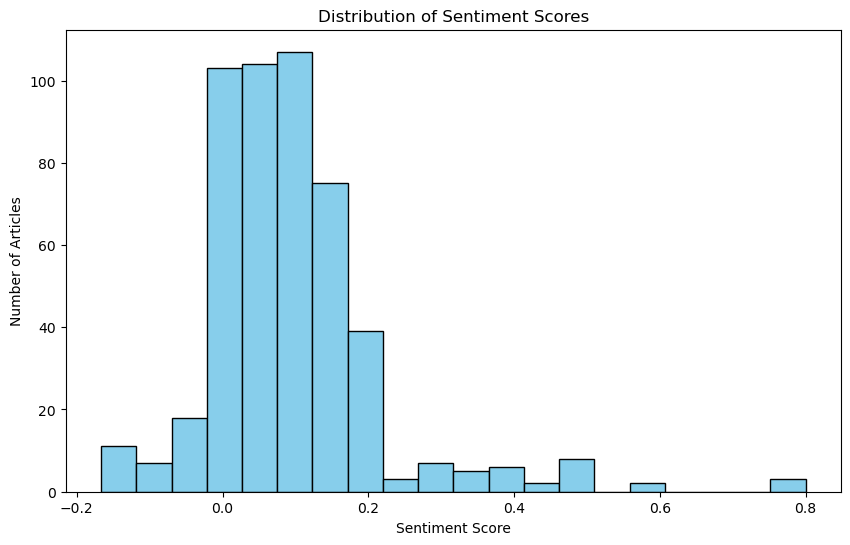

In [326]:
# Histogram of sentiment scores
plt.figure(figsize=(10, 6))
plt.hist(articles_df_sorted['Sentiment Score'], bins=20, color='skyblue', edgecolor='black')
plt.title("Distribution of Sentiment Scores")
plt.xlabel("Sentiment Score")
plt.ylabel("Number of Articles")
plt.show()

The histogram of sentiment scores shows a clustering around slightly positive scores, with fewer articles exhibiting high positivity or negativity. This distribution suggests that most articles have a balanced tone, with only a few articles at sentiment extremes.

#### Categorize Articles by Sentiment

In [327]:
# Categorize articles by sentiment
articles_df_sorted['Sentiment Category'] = articles_df_sorted['Sentiment Score'].apply(
    lambda x: 'Positive' if x > 0 else ('Negative' if x < 0 else 'Neutral')
)

# Count the number of articles in each sentiment category
category_counts = articles_df_sorted['Sentiment Category'].value_counts()
print("\nNumber of Articles by Sentiment Category:")
print(category_counts)


Number of Articles by Sentiment Category:
Sentiment Category
Positive    377
Neutral      77
Negative     46
Name: count, dtype: int64


**Positive Articles:** The majority of articles (377) have a positive sentiment.\
**Neutral Articles:** A significant portion (77 articles) is neutral, showing balanced or neutral news coverage.\
**Negative Articles:** A smaller number of articles (46) are negative, indicating that negative sentiment is less common.

#### Top Positive and Negative Articles

In [334]:
# Top 5 positive articles
top_positive = articles_df_sorted.head(5)
print("\nTop 5 Positive Articles:")
top_positive[['Ticker', 'Date', 'Article Content', 'Sentiment Score', 'Article Link']]


Top 5 Positive Articles:


,Ticker,Date,Article Content,Sentiment Score,Article Link
0,AMZN,2024-11-03 21:29:02,Amazon India's Great Indian Festival 2024 Achi...,0.8,https://www.goodreturns.in/personal-finance/gr...
1,AMZN,2024-11-03 21:29:06,Amazon India's Great Indian Festival 2024 Achi...,0.8,https://www.goodreturns.in/personal-finance/gr...
2,AMZN,2024-11-03 21:29:04,Amazon India's Great Indian Festival 2024 Achi...,0.8,https://www.goodreturns.in/personal-finance/gr...
3,V,2024-11-03 15:31:19,There's more to\n\nthe story\n\nSign in to unl...,0.6,https://wswanderersfc.com.au/videos/id/newcast...
4,V,2024-11-03 15:31:12,There's more to\n\nthe story\n\nSign in to unl...,0.6,https://wswanderersfc.com.au/videos/id/newcast...


The most positive articles are concentrated around Amazon (AMZN) and Visa (V), with 3 and 2 articles, respectively. This suggests that recent news for these companies has been highly favorable.

In [335]:
# Top 5 negative articles
top_negative = articles_df_sorted.tail(5)
print("\nTop 5 Negative Articles:")
top_negative[['Ticker', 'Date', 'Article Content', 'Sentiment Score', 'Article Link']]


Top 5 Negative Articles:


,Ticker,Date,Article Content,Sentiment Score,Article Link
495,PG,2024-11-03 15:31:28,NEET PG Counselling 2024 Schedule: The Medical...,-0.163636,https://english.jagran.com/education/neet-pg-c...
496,PG,2024-11-03 15:31:35,NEET PG Counselling 2024 Schedule: The Medical...,-0.163636,https://english.jagran.com/education/neet-pg-c...
497,TSLA,2024-11-03 21:30:01,Tesla Investors Confuse 'Valuation And Stock P...,-0.166667,https://www.msn.com/en-us/money/news/tesla-inv...
498,TSLA,2024-11-03 21:30:06,Tesla Investors Confuse 'Valuation And Stock P...,-0.166667,https://www.msn.com/en-us/money/news/tesla-inv...
499,TSLA,2024-11-03 21:30:11,Tesla Investors Confuse 'Valuation And Stock P...,-0.166667,https://www.msn.com/en-us/money/news/tesla-inv...


The most negative articles are related to Procter & Gamble (PG) and Tesla (TSLA), with 2 and 3 articles, respectively, indicating some unfavorable coverage for these companies.

### Key Takeaways
- **Amazon** and **Visa** are currently viewed favorably in the media, as evidenced by the high sentiment scores in their top articles.
- **Tesla** and **Procter & Gamble** have some negative coverage, which may impact public perception or investor sentiment toward these companies.
- Overall, the news sentiment is slightly positive, but the presence of neutral articles suggests a balanced representation of information.

* Repeat the sentiment analysis using a Naive Bayes classifier. Compare the results from TextBlob and Naive Bayes to select 10 stocks for your portfolio based on the most positive sentiment trends.

### Problem 4: 
Upload the ratings.csv data set with movieId, userId, and the rating as columns and do the following. 
* Filter out all movies that have received fewer than 100 ratings. Then, create a utility matrix using the filtered data.
* Convert the utility matrix to a DataFrame and calculate the number of missing ratings. Also, compute the percentage of missing values in this sparse matrix.
* Build an SVD-based collaborative filtering recommender system to predict movie ratings. Calculate the RMSE for the model. Additionally, find a userId who has rated a movie and use the model to generate the top 5 movie recommendations for that user.

In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', 20)

In [43]:
data_loc = "/Users/gabrielvictorgomesferreira/Library/Mobile Documents/com~apple~CloudDocs/Work/ISU Classes/Data/"
file_name = "ratings.csv"

In [44]:
ratings_df = pd.read_csv(data_loc + file_name)
rows, columns = ratings_df.shape
print(f"The dataset contains {rows:,} rows and {columns} columns")
ratings_df.head(5)

The dataset contains 100,836 rows and 3 columns


,userId,movieId,rating
0,1,1,4.0
1,1,3,4.0
2,1,6,4.0
3,1,47,5.0
4,1,50,5.0


* Filter out all movies that have received fewer than 100 ratings. Then, create a utility matrix using the filtered data.

In [58]:
# Identifying the movies less than 100 ratings
pop_movies = ratings_df['movieId'].value_counts()
pop_movies = pop_movies[pop_movies > 100].index

# Filtering them out
ratings_filtered = ratings_df[ratings_df['movieId'].isin(pop_movies)]
ratings_filtered

,userId,movieId,rating
0,1,1,4.0
2,1,6,4.0
3,1,47,5.0
4,1,50,5.0
7,1,110,4.0
...,...,...,...
100217,610,48516,5.0
100310,610,58559,4.5
100326,610,60069,4.5
100380,610,68954,3.5


In [69]:
# Create a utility matrix with users as rows and movies as columns
utility_matrix = ratings_filtered.pivot(index='userId', columns='movieId', values='rating')
utility_matrix[0:5]

movieId,1,2,6,10,32,34,39,47,50,110,...,7153,7361,7438,8961,33794,48516,58559,60069,68954,79132
userId,,,,,,,,,,,,,,,,,,,,,
1,4.0,NaN,4.0,NaN,NaN,NaN,NaN,5.0,5.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,4.0,4.5,NaN,NaN,4.0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,2.0,NaN,NaN,2.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,4.0,NaN,NaN,NaN,NaN,4.0,3.0,NaN,4.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


* Convert the utility matrix to a DataFrame and calculate the number of missing ratings. Also, compute the percentage of missing values in this sparse matrix.

In [77]:
utility_matrix_df = pd.DataFrame(utility_matrix)
num_missing_ratings = utility_matrix_df.isna().sum().sum()
num_missing_ratings

60210

In [78]:
# Calculate the total number of values in the matrix
total_values = utility_matrix.size
total_values

79998

In [82]:
# Calculate the percentage of missing values
percent_missing = round((num_missing_ratings / total_values) * 100, 2)

# Display the results
print("Number of missing ratings:", num_missing_ratings)
print(f"Percentage of missing values: {percent_missing}%")

Number of missing ratings: 60210
Percentage of missing values: 75.26%


#### Utility Matrix Analysis

The utility matrix shows significant sparsity in the dataset, with 60,210 missing ratings, representing 75.26% of the data. 

This high percentage of missing values is typical in real-world recommendation systems, where users interact with only a small fraction of available items. Such sparsity is a challenge but also highlights the value of collaborative filtering methods like SVD, which can predict missing ratings by uncovering latent patterns in user behavior and item characteristics. 

The utility matrix’s structure allows us to systematically handle and analyze these missing values, making it a crucial tool for effective recommendations despite incomplete data.

* Build an SVD-based collaborative filtering recommender system to predict movie ratings. Calculate the RMSE for the model. Additionally, find a userId who has rated a movie and use the model to generate the top 5 movie recommendations for that user.

In [86]:
from surprise import Dataset, Reader
from surprise import SVD
from surprise.model_selection import train_test_split, cross_validate
from surprise import accuracy
from surprise.accuracy import rmse

### Model Training and Evaluation

In [92]:
# Define a Reader with the appropriate rating scale
reader = Reader(rating_scale=(ratings_df['rating'].min(), ratings_df['rating'].max()))
data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)

# Train-Test Split
trainset, testset = train_test_split(data, test_size=0.2, random_state=42)

# Initialize and Train the SVD Model
svd = SVD(n_epochs=20, lr_all=0.005, reg_all=0.2)
svd.fit(trainset)

# Evaluate the Model
predictions = svd.test(testset)
rmse_score = rmse(predictions)
print("RMSE:", rmse_score)

RMSE: 0.8805
RMSE: 0.8805328477373325


### Cross-Validation

In [102]:
cross_validate(svd, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.8689  0.8703  0.8709  0.8856  0.8747  0.8741  0.0061  
MAE (testset)     0.6707  0.6711  0.6713  0.6794  0.6742  0.6733  0.0033  
Fit time          0.91    1.02    0.87    1.07    0.88    0.95    0.08    
Test time         0.31    0.20    2.42    0.10    0.10    0.62    0.90    


{'test_rmse': array([0.86887032, 0.870294  , 0.87085634, 0.88561234, 0.87468257]),
 'test_mae': array([0.67072436, 0.67109641, 0.67125213, 0.67938632, 0.67419942]),
 'fit_time': (0.9120039939880371,
  1.0182032585144043,
  0.8686258792877197,
  1.0672190189361572,
  0.8846390247344971),
 'test_time': (0.306441068649292,
  0.20035314559936523,
  2.415268898010254,
  0.0992732048034668,
  0.09607696533203125)}

#### Cross-Validation Analysis

The evaluation of the SVD algorithm across 5 folds shows consistent performance, with an average RMSE of 0.8741 and an MAE of 0.6733. 

These metrics indicate that the model’s predictions are reasonably accurate, though some variability exists (as seen in the standard deviations). RMSE, being slightly higher, suggests the presence of occasional larger errors, whereas the lower MAE indicates generally stable performance with smaller average errors. 

These results suggest that SVD provides a robust foundation for accurate recommendations, though further tuning may reduce occasional outliers in predictions.

### User Recommendations

In [100]:
# Select a user who has rated movies
user_id = ratings_df['userId'].sample(1).iloc[0]  # Randomly selecting a userId for demonstration

# Get all movies and filter for those the user has not rated
all_movie_ids = ratings_df['movieId'].unique()
rated_movie_ids = ratings_df[ratings_df['userId'] == user_id]['movieId'].values
unrated_movie_ids = [movie_id for movie_id in all_movie_ids if movie_id not in rated_movie_ids]

# Predict ratings for movies the user hasn't rated
predictions = [svd.predict(user_id, movie_id) for movie_id in unrated_movie_ids]

# Sort predictions by estimated rating in descending order and select top 5
top_5_recommendations = sorted(predictions, key=lambda x: x.est, reverse=True)[:5]


print(f"Top 5 movie recommendations for user {user_id}:")
for pred in top_5_recommendations:
    print(f"Movie ID: {pred.iid}, Predicted Rating: {pred.est:.2f}")

Top 5 movie recommendations for user 414:
Movie ID: 898, Predicted Rating: 4.06
Movie ID: 1283, Predicted Rating: 4.04
Movie ID: 3435, Predicted Rating: 4.04
Movie ID: 2160, Predicted Rating: 4.02
Movie ID: 306, Predicted Rating: 4.00
